<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#WHY" data-toc-modified-id="WHY-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>WHY</a></span></li><li><span><a href="#Ideas" data-toc-modified-id="Ideas-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Ideas</a></span></li><li><span><a href="#Implementation" data-toc-modified-id="Implementation-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Implementation</a></span></li><li><span><a href="#Import" data-toc-modified-id="Import-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Import</a></span></li><li><span><a href="#CSS-Time---no-JSON" data-toc-modified-id="CSS-Time---no-JSON-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>CSS Time - no JSON</a></span></li><li><span><a href="#City-and-price-limit-choice" data-toc-modified-id="City-and-price-limit-choice-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>City and price limit choice</a></span></li><li><span><a href="#Pages" data-toc-modified-id="Pages-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Pages</a></span></li><li><span><a href="#Script-for-one-city" data-toc-modified-id="Script-for-one-city-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Script for one city</a></span></li><li><span><a href="#Function-city_scrape()" data-toc-modified-id="Function-city_scrape()-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Function city_scrape()</a></span></li><li><span><a href="#Check-the-dataset" data-toc-modified-id="Check-the-dataset-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Check the dataset</a></span></li><li><span><a href="#Get-insights" data-toc-modified-id="Get-insights-11"><span class="toc-item-num">11&nbsp;&nbsp;</span>Get insights</a></span></li><li><span><a href="#Study-of-cities" data-toc-modified-id="Study-of-cities-12"><span class="toc-item-num">12&nbsp;&nbsp;</span>Study of cities</a></span></li><li><span><a href="#Tool-for-my-search" data-toc-modified-id="Tool-for-my-search-13"><span class="toc-item-num">13&nbsp;&nbsp;</span>Tool for my search</a></span></li><li><span><a href="#Thoughts-and-improvements" data-toc-modified-id="Thoughts-and-improvements-14"><span class="toc-item-num">14&nbsp;&nbsp;</span>Thoughts and improvements</a></span></li><li><span><a href="#If-i-were-to-start-from-scratch..." data-toc-modified-id="If-i-were-to-start-from-scratch...-15"><span class="toc-item-num">15&nbsp;&nbsp;</span>If i were to start from scratch...</a></span></li></ul></div>

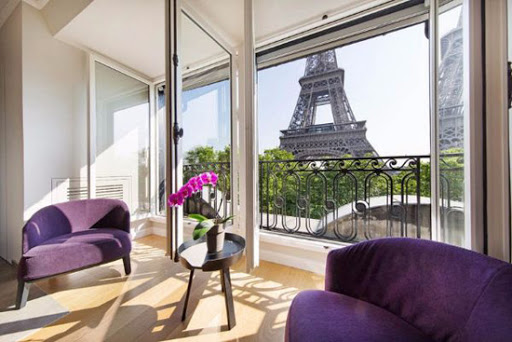

# WHY

who ever seached for an apartment in Paris?

You probably want that
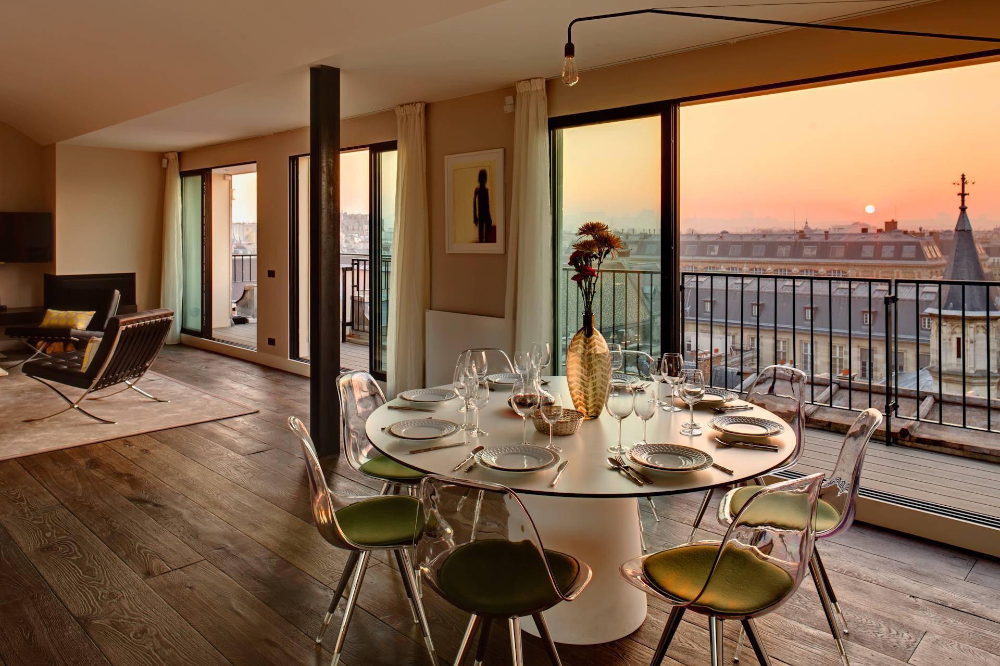
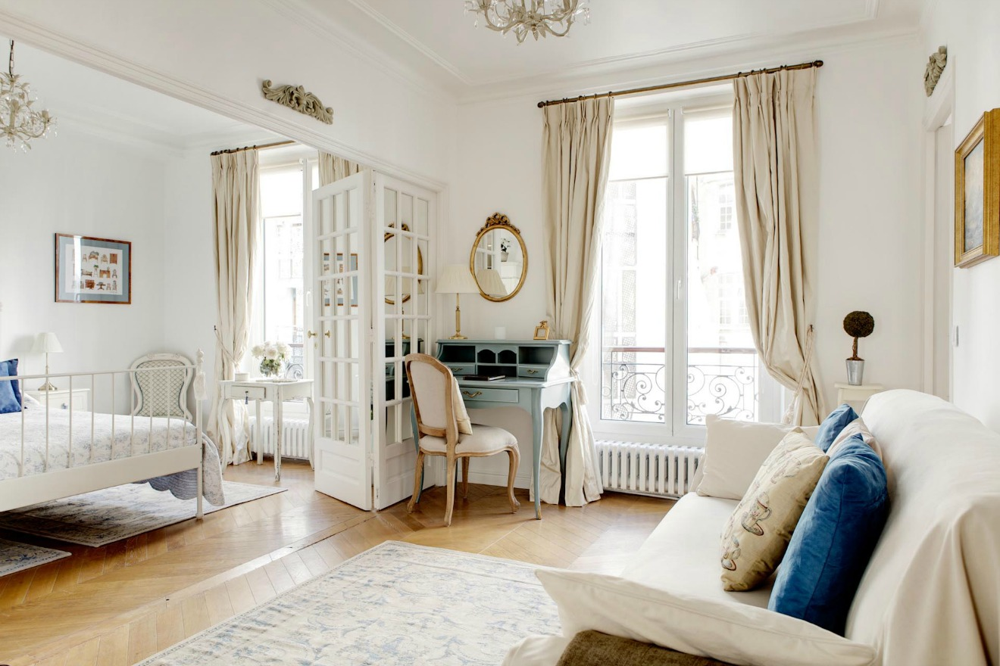

but who really lived in Paris has that
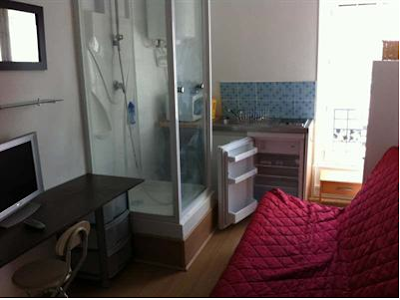
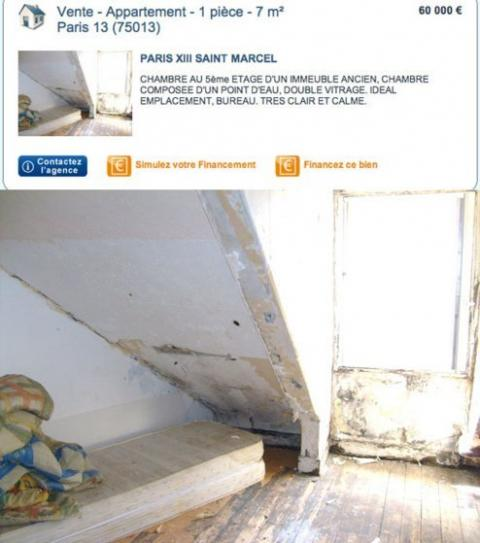
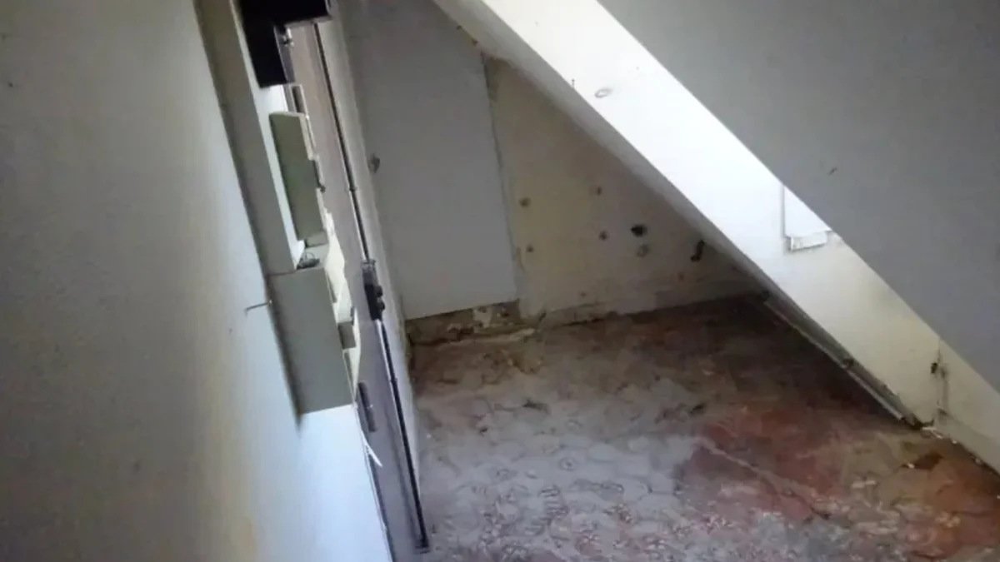

# Ideas


- **scrape the websites to get a base of apartments**
    - pap.fr
    - seloger.fr
    - flatlooker.com
    - leboncoin.fr
- **analyse the dataset**
    * find best apartments by price/goodness ratio
- **market research**
    - price to m2, square meter price to m2
    - compare that to other cities
- **have a tool to choose the apartments**
    - which will be really useful
- **NOT GET BANNED**

# Implementation

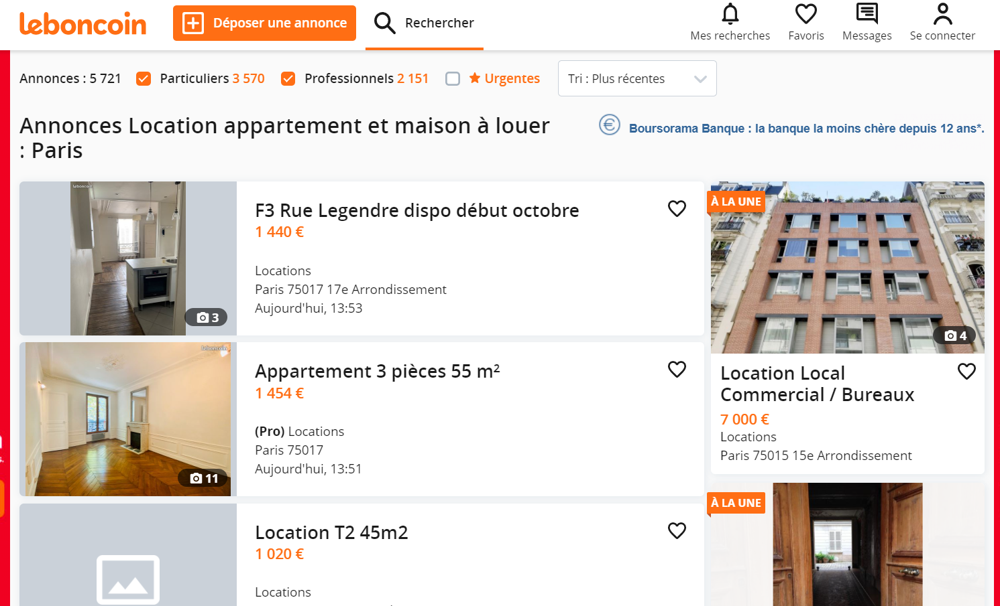
__________________________________
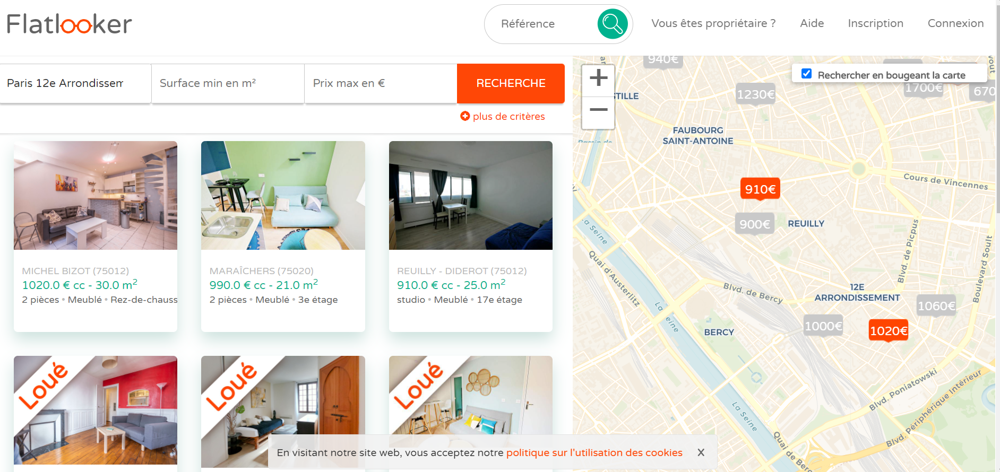
__________________________________
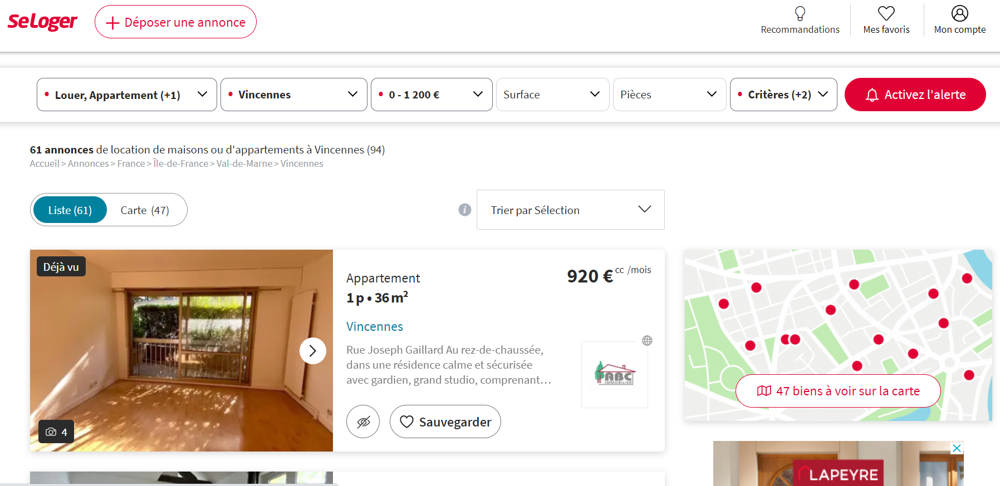
__________________________________
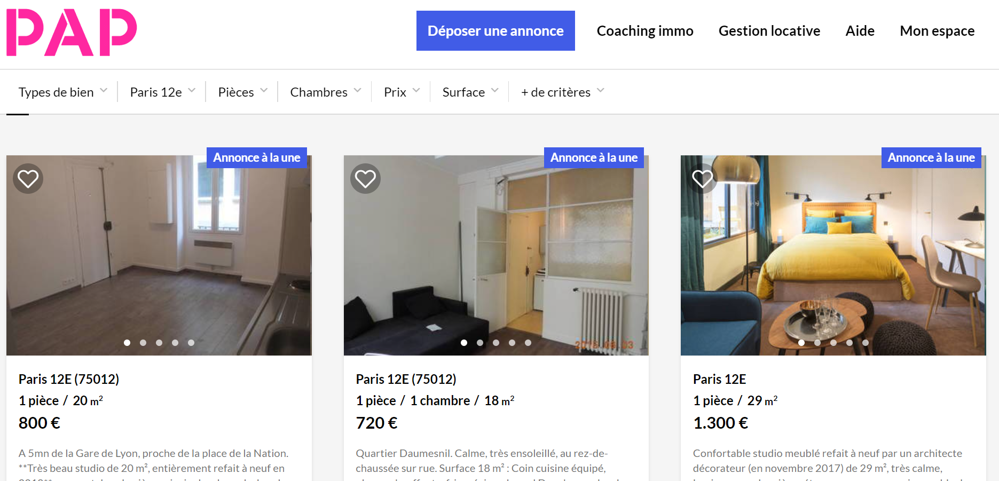

In short:
- search a flat is a mess
- so I will make a tool for myself
- maybe concentrate on agencies market (cheaper, more pro, and I already looked pap.fr)
- SADNESS

# Import

In [1]:
import requests as r
import re
from bs4 import BeautifulSoup
import pandas as pd
import numpy as np
import seaborn as sns
import time
import matplotlib.pyplot as plt
%matplotlib inline
sns.set()
import warnings
warnings.simplefilter('ignore') #ignore the warnings, not the errors

# CSS Time - no JSON

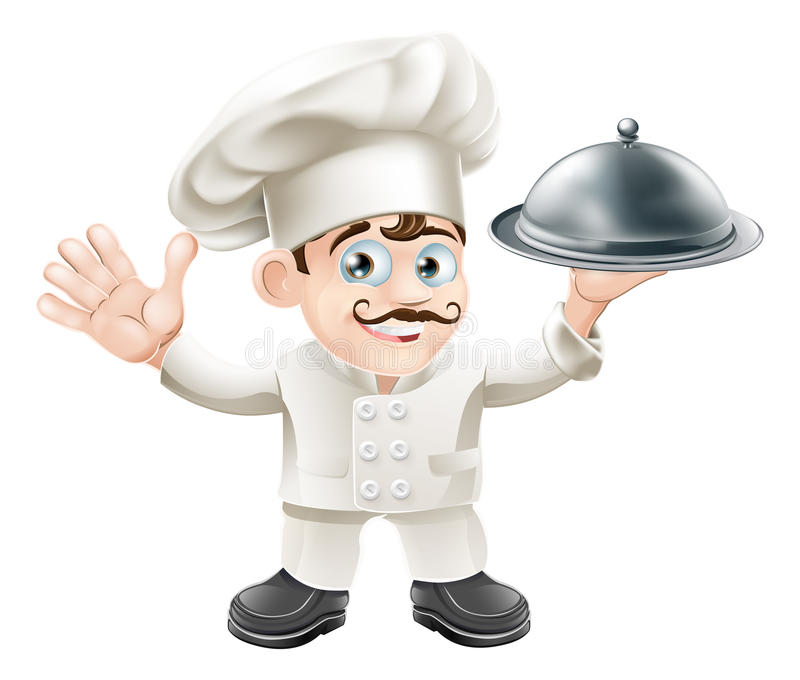

In [181]:
headers='''accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9
accept-encoding: gzip, deflate, br
accept-language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7
cache-control: no-cache
cookie: __uzma=ce43d0df-cf1f-2c29-2aec-b33650f94070; __uzmb=1600352246; visitId=1600352256137-1282661506; theshield_cmp_consent={%22consentString%22:%22eyJhdWRpZW5jZSI6WyIqIl0sInNvY2lhbCI6WyIqIl0sImFuYWx5dGljcyI6WyIqIl0sImlhYiI6W3siaWQiOjEsInZlbmRvcnMiOlsiKiJdfSx7ImlkIjoyLCJ2ZW5kb3JzIjpbIioiXX0seyJpZCI6MywidmVuZG9ycyI6WyIqIl19LHsiaWQiOjQsInZlbmRvcnMiOlsiKiJdfSx7ImlkIjo1LCJ2ZW5kb3JzIjpbIioiXX1dLCJhZHMiOlsiKiJdfQ%253D%253D%22}; theshield_consent={%22consentString%22:%22BO54mABO54mACCyABBFRDX-AAAAyh7_______9_-____9uz_Ov_v_f__33e8__9v_l_7_-___u_-23d4u_1vf99ycmx-5etr3tp_47ues2_Xurf_71__3z3_9pxP78E89r5335EQ_v-_t-b7BCHN_Y2v-8K96lPKACEI%22}; bannerCookie=1; _gid=GA1.2.599543976.1600352257; _gcl_au=1.1.639888550.1600352257; atuserid=%7B%22name%22%3A%22atuserid%22%2C%22val%22%3A%227e452564-b32a-45d3-84cf-6aca62500a7a%22%2C%22options%22%3A%7B%22end%22%3A%222021-10-19T14%3A17%3A37.200Z%22%2C%22path%22%3A%22%2F%22%7D%7D; s_ecid=MCMID%7C70576640173330827904478951065477246374; ry_ry-s3oa268o_realytics=eyJpZCI6InJ5X0Y4MDlDMEZDLUI1QkQtNDhBRS1BOEVCLUQxQTlGQUEzMzkxMiIsImNpZCI6bnVsbCwiZXhwIjoxNjMxODg4MjU3NjYyLCJjcyI6MX0%3D; realytics=1; mics_uaid=web:1056:dccfc1cf-fa91-4707-ab20-d6bf3003b4db; uid=dccfc1cf-fa91-4707-ab20-d6bf3003b4db; mics_vid=7661734660; mics_lts=1600352283115; mics_vid=7661734660; mics_lts=1600352283115; kameleoonVisitorCode=_js_djh90c63ne2fw6dx; AMCVS_366134FA53DB27860A490D44%40AdobeOrg=1; AMCV_366134FA53DB27860A490D44%40AdobeOrg=1099438348%7CMCIDTS%7C18523%7CMCMID%7C70576640173330827904478951065477246374%7CMCAAMLH-1600957057%7C6%7CMCAAMB-1601044861%7CRKhpRz8krg2tLO6pguXWp5olkAcUniQYPHaMWWgdJ3xzPWQmdj0y%7CMCOPTOUT-1600447261s%7CNONE%7CMCAID%7CNONE%7CvVersion%7C2.1.0; s_visit=1; s_dl=1; s_cc=true; ry_ry-s3oa268o_so_realytics=eyJpZCI6InJ5X0Y4MDlDMEZDLUI1QkQtNDhBRS1BOEVCLUQxQTlGQUEzMzkxMiIsImNpZCI6bnVsbCwib3JpZ2luIjp0cnVlLCJyZWYiOm51bGwsImNvbnQiOm51bGwsIm5zIjpmYWxzZX0%3D; s_sq=%5B%5BB%5D%5D; _gat_UA-155862534-1=1; _ga=GA1.1.1975478801.1600352257; _ga_0J0SN5QME8=GS1.1.1600440058.2.1.1600440271.0; s_getNewRepeat=1600440273859-Repeat; c_m=undefinedvalidate.perfdrive.comOther%20Natural%20Referrersundefined; stack_ch=%5B%5B%27SEO%2520Non%2520Branded%27%2C%271600352257628%27%5D%2C%5B%27Autres%2520Sites%2520Organiques%27%2C%271600354187686%27%5D%2C%5B%27Acces%2520Direct%27%2C%271600440061206%27%5D%2C%5B%27Autres%2520Sites%2520Organiques%27%2C%271600440273922%27%5D%5D; __uzmd=1600440281; __uzmc=4382622643986
pragma: no-cache
referer: http://validate.perfdrive.com/seloger/captcha?ssa=296f0c18-13bd-a956-129f-4a57a09c41fa&ssc=http%3A%2F%2Fwww.seloger.com%2Flist.htm%3Fprojects%3D1%26types%3D2%252C1%26natures%3D1%26places%3D%255B%257Bci%253A940080%257D%255D%26price%3DNaN%252F1200%26enterprise%3D0%26qsVersion%3D1.0%26LISTING-LISTpg%3D2&ssi=bf91b92c-88be-c7c2-774c-b542755ea6f1&ssk=contactus@shieldsquare.com&ssm=698473245238409852083630155506451&ssn=6c7f71d96b86979d795dd082e524762c4dafce43d0df-cf1f-2c29-2da22a&sso=4c6e0aec-b33650f940706fe0a94130a3e14c9101bb0007bd6c772ee0&ssp=11956739591600353358160047518145359&ssq=00863494025845203415652246489617106875263&ssr=OTEuMTY2LjE1Mi4xNTk=&sst=Mozilla/5.0%20(Windows%20NT%2010.0;%20Win64;%20x64)%20AppleWebKit/537.36%20(KHTML,%20like%20Gecko)%20Chrome/85.0.4183.102%20Safari/537.36&ssw=
sec-fetch-dest: document
sec-fetch-mode: navigate
sec-fetch-site: same-origin
sec-fetch-user: ?1
upgrade-insecure-requests: 1
user-agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/85.0.4183.102 Safari/537.36'''

In [182]:
headers=dict([i.strip().split(': ') for i in headers.split('\n')])
url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places=[{ci:940080}]&price=NaN/1200&enterprise=0&qsVersion=1.0&LISTING-LISTpg=3'
html=r.get(url,headers=headers).content
soup=BeautifulSoup(html)

In [183]:
surface_m2=[float(i.replace(',','.')) for i in re.findall(r'li\>([0-9,]+) m²\<\/li\>', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]

In [184]:
rooms=[int(i.strip()[0]) for i in re.findall(r'\d [p]', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]

In [185]:
price=[int(''.join(i.text.split()[:-1])) for i in soup.select('div.Price__Label-sc-1g9fitq-1')]

In [186]:
links=[i.get('href') for i in soup.select('.Card__ContentZone-sc-7insep-3 a.CoveringLink-a3s3kt-0')]

In [187]:
df=pd.DataFrame(price)
df.columns=['Price']
df['N_rooms'] = rooms
df['Surface_m2'] = surface_m2
df['Link'] = links
df.head()

,Price,N_rooms,Surface_m2,Link
0,1150,2,35.0,https://www...
1,995,2,28.0,https://www...
2,980,1,30.0,https://www...
3,1200,2,38.0,https://www...
4,995,1,32.0,https://www...


# City and price limit choice

In [21]:
#full paris
zone=str('[{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}|{ci:750116}|{ci:750117}|{ci:750118}|{ci:750119}|{ci:750101}|{ci:750102}|{ci:750103}|{ci:750104}|{ci:750105}|{ci:750106}|{ci:750107}|{ci:750108}|{ci:750109}|{ci:750110}]')

In [188]:
#11-15 Paris
zone=str('[{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]')

In [23]:
#vincennes
zone=str('[{ci:940080}]')

In [116]:
#lyon full
zone=str('[{ci:690123}]')

In [94]:
#nantes10
zone=str('[{ci:440109}]')

In [15]:
#Toulouse full
zone=str('[{ci:310555}]')

In [10]:
#Nice full
zone=str('[{ci:60088}]')

In [189]:
price_limit=str(1200)

# Pages

In [190]:
print(zone)
url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg=1'
html=r.get(url,headers=headers).content
soup=BeautifulSoup(html)
pages=int(int(soup.select('div.Status__StatusContainer-yh17cz-0')[0].text.split(' ')[-1])/25)+1
pages

[{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]


27

# Script for one city

In [170]:
def city_scrape():
    
    # price input

    price_limit=str(input('What is the max price for your research?'))

    # create the dataset and get pages number

    df = pd.DataFrame()
    url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg=1'
    html=r.get(url,headers=headers).content
    soup=BeautifulSoup(html)
    pages=int(int(soup.select('div.Status__StatusContainer-yh17cz-0')[0].text.split(' ')[-1])/25)+1
    
    # notify user about pages quantity
    
    print('You can expect to get the results for ' + str(pages) + ' pages')

    # loop over every page

    for k in range(1, pages+1):
        try:

            # get the soup from a link

            print('Getting values from page '+str(k)+' for '+zone+'...')

            url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg='+str(k)
            html=r.get(url,headers=headers).content
            soup=BeautifulSoup(html)

            # get the info for every column

            surface_m2=[float(i.replace(',','.')) for i in re.findall(r'li\>([0-9,]+) m²\<\/li\>', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
            rooms=[int(i.strip()[0]) for i in re.findall(r'\d [p]', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
            price=[int(''.join(i.text.split()[:-1])) for i in soup.select('div.Price__Label-sc-1g9fitq-1')]
            links=[i.get('href') for i in soup.select('.Card__ContentZone-sc-7insep-3 a.CoveringLink-a3s3kt-0')]

            # append to the dataset

            df_local=pd.DataFrame(price)
            df_local.columns=['Price']
            df_local['N_rooms'] = rooms
            df_local['Surface_m2'] = surface_m2
            df_local['Link'] = links
            df=df.append(df_local, ignore_index = True) 

            # two seconds - not to get banned

            time.sleep(2)

        # in case of an error - skip the page:

        except:
            print(f'Encountered a problem on page {k}, continuing to the next page...')
            continue

    # create new columns and print Done

    df['Price_per_m2'] = df.Price / df.Surface_m2        
    print('Done!')
    
    return df

# Function city_scrape()

In [191]:
df=city_scrape()

What is the max price for your research?1200
You can expect to get the results for 27 pages
Getting values from page 1 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 2 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 3 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 4 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 5 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Encountered a problem on page 5, continuing to the next page...
Getting values from page 6 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 7 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 8 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 9 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:7501

# Check the dataset

In [192]:
pd.set_option('display.max_colwidth', 20) #characters in columns to show
df

,Price,N_rooms,Surface_m2,Link,Price_per_m2
0,891,1,24.00,https://www.selo...,37.125000
1,975,1,20.47,https://www.selo...,47.630679
2,1060,1,18.17,https://www.selo...,58.337920
3,990,1,17.00,https://www.selo...,58.235294
4,940,1,29.58,https://www.selo...,31.778229
...,...,...,...,...,...
594,985,1,23.00,https://www.selo...,42.826087
595,1200,3,41.00,https://www.selo...,29.268293
596,945,1,20.00,https://www.selo...,47.250000
597,945,1,20.00,https://www.selo...,47.250000


In [194]:
df.pivot_table(index='N_rooms', values='Surface_m2', aggfunc='mean')
#df.pivot_table(index='N_rooms', values='Price', aggfunc='mean')

,Surface_m2
N_rooms,
1,25.411127
2,34.264917
3,46.618750
4,100.000000
6,89.000000


# Get insights

![ChessUrl](https://media3.giphy.com/media/LQiq27myXGPXO6WzAE/giphy.gif "matrix")

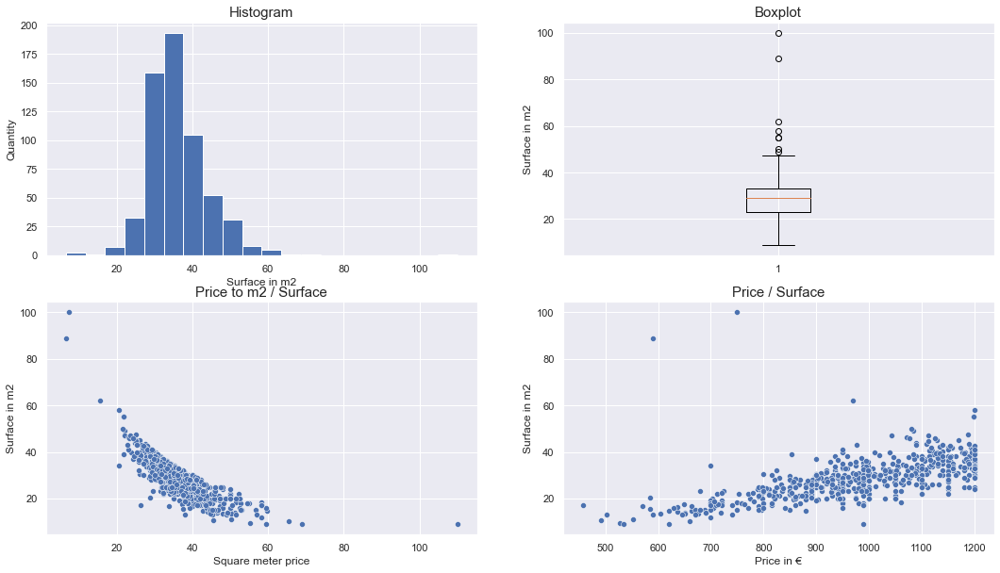

In [195]:
# dashboard

_, axes=plt.subplots(2,2,figsize=(18,10))

axes[0, 0].set_title('Histogram', size=15)
axes[0, 1].set_title('Boxplot', size=15)
axes[1, 0].set_title('Price to m2 / Surface', size=15)
axes[1, 1].set_title('Price / Surface', size=15)

axes[0, 0].set(xlabel='Surface in m2', ylabel='Quantity')
axes[0, 1].set(ylabel='Surface in m2')
axes[1, 0].set(xlabel='Square meter price', ylabel='Surface in m2')
axes[1, 1].set(xlabel='Price in €', ylabel='Surface in m2')


axes[0,0].hist(df['Price_per_m2'], bins=20)
axes[0,1].boxplot(df['Surface_m2'])
sns.scatterplot(df.Price_per_m2, df.Surface_m2,ax=axes[1,0])
sns.scatterplot(df.Price, df.Surface_m2,ax=axes[1,1]);

In [196]:
print('Correlation coefficient between Price and Surface in m2 is ' + str(round(np.corrcoef(df.Price, df.Surface_m2)[0,1],2)))
print('Correlation coefficient between Square meter price and Surface in m2 is ' + str((round(np.corrcoef(df.Price_per_m2, df.Surface_m2)[0,1],2))*(-1)))

Correlation coefficient between Price and Surface in m2 is 0.59
Correlation coefficient between Square meter price and Surface in m2 is 0.79


# Study of cities

In [84]:
# create the dataset and get pages number

df_big = pd.DataFrame()
#url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/1200&enterprise=0&qsVersion=1.0&LISTING-LISTpg=1'
#html=r.get(url,headers=headers).content
#soup=BeautifulSoup(html)
#pages=int(int(soup.select('div.Status__StatusContainer-yh17cz-0')[0].text.split(' ')[-1])/25)+1

                                                #what's your price limit?
                                                #where do you search? copy paste the choice
                                                #if pages > 30 then limit 30
zone=str('[{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]')
# loop over every page

for k in range(1, 10+1):
    try:
        
        # get the soup from a link
        
        print('Getting values from page '+str(k)+' for '+zone+'...')

        url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg='+str(k)
        html=r.get(url,headers=headers).content
        soup=BeautifulSoup(html)
        
        # get the info for every column
        
        surface_m2=[float(i.replace(',','.')) for i in re.findall(r'li\>([0-9,]+) m²\<\/li\>', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        rooms=[int(i.strip()[0]) for i in re.findall(r'\d [p]', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        price=[int(''.join(i.text.split()[:-1])) for i in soup.select('div.Price__Label-sc-1g9fitq-1')]
        links=[i.get('href') for i in soup.select('.Card__ContentZone-sc-7insep-3 a.CoveringLink-a3s3kt-0')]
        
        # append to the dataset
        
        df_local=pd.DataFrame(price)
        df_local.columns=['Price']
        df_local['N_rooms'] = rooms
        df_local['Surface_m2'] = surface_m2
        df_local['Link'] = links
        df_local['Zone'] = 'Paris_SudEst'
        df_big=df_big.append(df_local, ignore_index = True) 

        # two seconds - not to get banned
        time.sleep(2)
        
    # in case of an error - skip the page:
        
    except:
        print(f'Encountered a problem on page {k}, continuing to the next page...')
        continue

#2

zone=str('[{ci:690123}]')
# loop over every page

for k in range(1, 10+1):
    try:
        
        # get the soup from a link
        
        print('Getting values from page '+str(k)+' for '+zone+'...')

        url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg='+str(k)
        html=r.get(url,headers=headers).content
        soup=BeautifulSoup(html)
        
        # get the info for every column
        
        surface_m2=[float(i.replace(',','.')) for i in re.findall(r'li\>([0-9,]+) m²\<\/li\>', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        rooms=[int(i.strip()[0]) for i in re.findall(r'\d [p]', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        price=[int(''.join(i.text.split()[:-1])) for i in soup.select('div.Price__Label-sc-1g9fitq-1')]
        links=[i.get('href') for i in soup.select('.Card__ContentZone-sc-7insep-3 a.CoveringLink-a3s3kt-0')]
        
        # append to the dataset
        
        df_local=pd.DataFrame(price)
        df_local.columns=['Price']
        df_local['N_rooms'] = rooms
        df_local['Surface_m2'] = surface_m2
        df_local['Link'] = links
        df_local['Zone'] = 'Lyon'
        df_big=df_big.append(df_local, ignore_index = True) 

        # two seconds - not to get banned
        time.sleep(2)
        
    # in case of an error - skip the page:
        
    except:
        print(f'Encountered a problem on page {k}, continuing to the next page...')
        continue

#3

zone=str('[{ci:60088}]')
# loop over every page

for k in range(1, 10+1):
    try:
        
        # get the soup from a link
        
        print('Getting values from page '+str(k)+' for '+zone+'...')

        url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg='+str(k)
        html=r.get(url,headers=headers).content
        soup=BeautifulSoup(html)
        
        # get the info for every column
        
        surface_m2=[float(i.replace(',','.')) for i in re.findall(r'li\>([0-9,]+) m²\<\/li\>', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        rooms=[int(i.strip()[0]) for i in re.findall(r'\d [p]', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        price=[int(''.join(i.text.split()[:-1])) for i in soup.select('div.Price__Label-sc-1g9fitq-1')]
        links=[i.get('href') for i in soup.select('.Card__ContentZone-sc-7insep-3 a.CoveringLink-a3s3kt-0')]
        
        # append to the dataset
        
        df_local=pd.DataFrame(price)
        df_local.columns=['Price']
        df_local['N_rooms'] = rooms
        df_local['Surface_m2'] = surface_m2
        df_local['Link'] = links
        df_local['Zone'] = 'Nice'
        df_big=df_big.append(df_local, ignore_index = True) 

        # two seconds - not to get banned
        time.sleep(2)
        
    # in case of an error - skip the page:
        
    except:
        print(f'Encountered a problem on page {k}, continuing to the next page...')
        continue

#4
zone=str('[{ci:310555}]')

for k in range(1, 10+1):
    try:
        
        # get the soup from a link
        
        print('Getting values from page '+str(k)+' for '+zone+'...')

        url='https://www.seloger.com/list.htm?projects=1&types=2,1&natures=1&places='+zone+'&price=NaN/'+price_limit+'&enterprise=0&qsVersion=1.0&LISTING-LISTpg='+str(k)
        html=r.get(url,headers=headers).content
        soup=BeautifulSoup(html)
        
        # get the info for every column
        
        surface_m2=[float(i.replace(',','.')) for i in re.findall(r'li\>([0-9,]+) m²\<\/li\>', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        rooms=[int(i.strip()[0]) for i in re.findall(r'\d [p]', str(soup.select('ul.ContentZone__Tags-wghbmy-8')))]
        price=[int(''.join(i.text.split()[:-1])) for i in soup.select('div.Price__Label-sc-1g9fitq-1')]
        links=[i.get('href') for i in soup.select('.Card__ContentZone-sc-7insep-3 a.CoveringLink-a3s3kt-0')]
        
        # append to the dataset
        
        df_local=pd.DataFrame(price)
        df_local.columns=['Price']
        df_local['N_rooms'] = rooms
        df_local['Surface_m2'] = surface_m2
        df_local['Link'] = links
        df_local['Zone'] = 'Toulouse'
        df_big=df_big.append(df_local, ignore_index = True) 

        # two seconds - not to get banned
        time.sleep(2)
        
    # in case of an error - skip the page:
        
    except:
        print(f'Encountered a problem on page {k}, continuing to the next page...')
        continue

    
    
# create new columns and print Done

df['Price_per_m2'] = df.Price / df.Surface_m2        
print('Done!')

Getting values from page 1 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 2 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 3 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 4 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 5 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 6 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 7 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Encountered a problem on page 7, continuing to the next page...
Getting values from page 8 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 9 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci:750114}|{ci:750115}]...
Getting values from page 10 for [{ci:750112}|{ci:750111}|{ci:750113}|{ci

In [197]:
pd.set_option('display.max_colwidth', 15) #characters in columns to show
df_big

,Price,N_rooms,Surface_m2,Link,Zone
0,891,1,24.00,https://www...,Paris_SudEst
1,975,1,20.47,https://www...,Paris_SudEst
2,1060,1,18.17,https://www...,Paris_SudEst
3,990,1,17.00,https://www...,Paris_SudEst
4,950,1,18.42,https://www...,Paris_SudEst
...,...,...,...,...,...
892,660,3,55.00,https://www...,Toulouse
893,669,2,51.00,https://www...,Toulouse
894,511,2,37.00,https://www...,Toulouse
895,510,2,36.00,https://www...,Toulouse


In [198]:
import plotly.express as px

fig = px.scatter(x=df_big.Price, y=df_big.Surface_m2, color=df_big.Zone,labels={"x": "Price in €",  "y": "Surface in m2"})
fig.show()

In [199]:
import plotly.express as px

fig = px.scatter(x=df_big.Price, y=df_big.Surface_m2, color=df_big.Zone, marginal_x="box", marginal_y="box", labels={"x": "Price in €",  "y": "Surface in m2"})

fig.show()

# Tool for my search

In [200]:
import webbrowser
import plotly.graph_objs as go
import plotly.express as px

fig = go.FigureWidget(layout={'hovermode': 'closest'})
scatter = fig.add_scatter(x=df.Price, y=df.Surface_m2, mode='markers',fillcolor='azure')
data = fig.data[0]

fig2 = px.scatter(x=df.Price, y=df.Surface_m2, trendline="ols")
trendline = fig2.data[1] # second trace, first one is scatter
fig.add_trace(trendline)

fig.update_xaxes(title_text="Price in €")
fig.update_yaxes(title_text="Surface in m2")

def do_click(trace, points, state):
    if points.point_inds:
        ind = points.point_inds[0]
        link = df.Link.iloc[ind]
        webbrowser.open_new_tab(link)

        
data.on_click(do_click)
fig

FigureWidget({
    'data': [{'fillcolor': 'azure',
              'mode': 'markers',
              'type': 'sca…

# Thoughts and improvements

- remove outliers on graphs; hue graphs by photo quantity
- add person input for a city and wrap it in a function TO HAVE ONE LINE
- do the same for booking.com
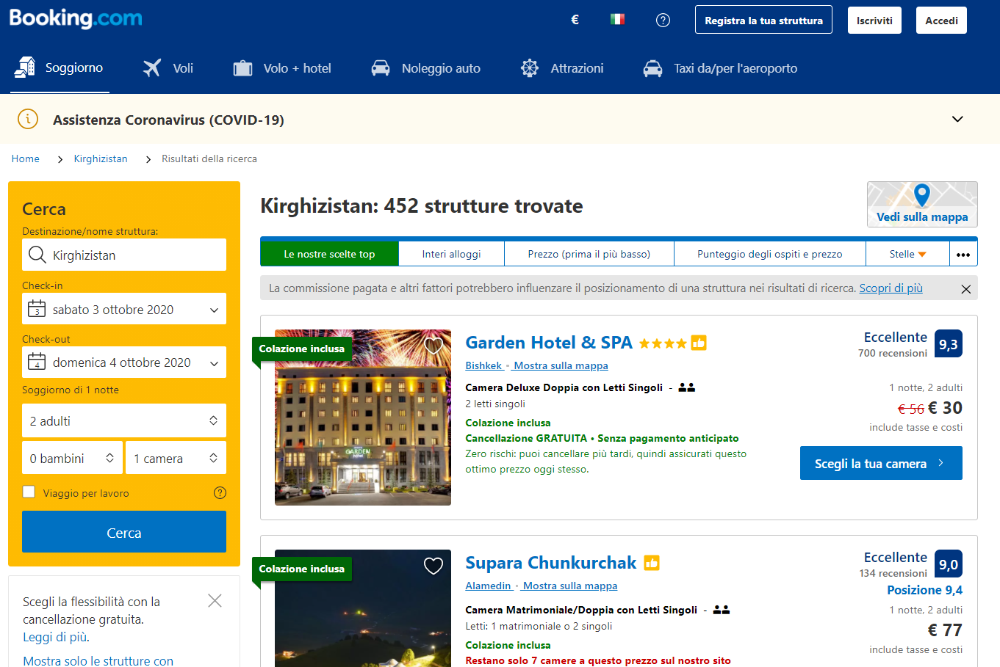

- ADD MORE TABLEAU PIE CHARTS
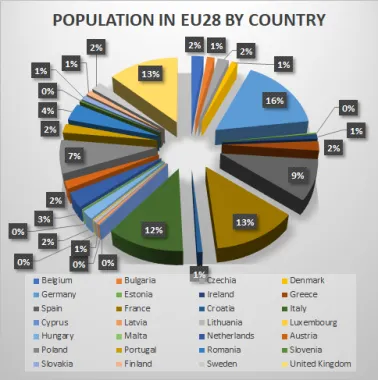

# If i were to start from scratch...

- I would choose something more motivating than apartments
- add error handling for captcha
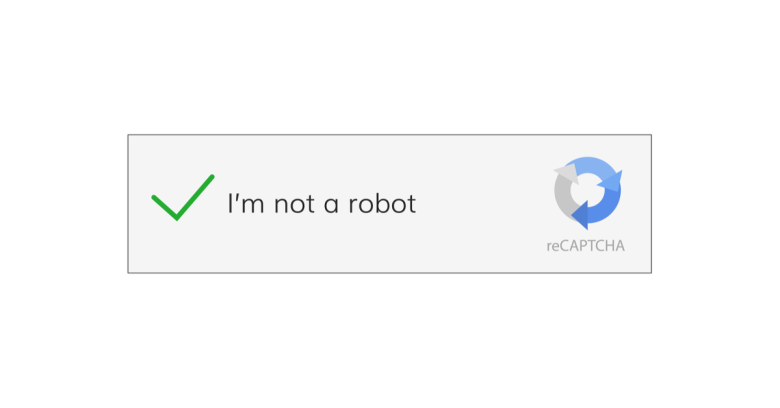


- (after week 8) LEARNING MACHINES

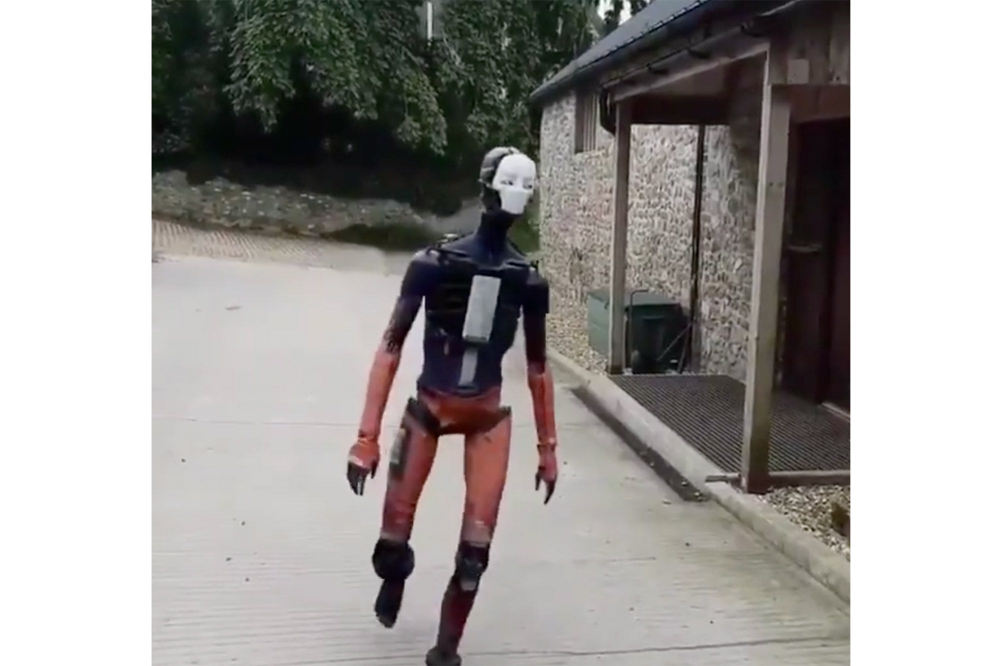